In [1]:
import os
import json
import networkx as nx
from matplotlib import pyplot as plt

In [2]:
node_colors = {
    'SPD': 'red',
    'CDU': 'black',
    'AfD': 'blue',
    'AFD': 'blue',
    'FDP': 'yellow',
    'Bündnis 90/Die Grünen': 'green',
    'Die Linke': 'purple',
    'CSU': 'lightblue',
    'Fraktionslos': 'grey',
    'additional': 'orange'
}

In [3]:
ALL_POLITICIANS_FILE = '../../assets/all_politicians.json'
NEWS_PORTALS_FILE = '../../assets/news_portals.json'
VIROLOGISTS_FILE = '../../assets/virologists.json'

with open(ALL_POLITICIANS_FILE, 'r', encoding='utf-8') as infile_all_politicians:
    all_politicians = json.load(infile_all_politicians)
with open(NEWS_PORTALS_FILE, 'r', encoding='utf-8') as infile_news_portals:
    news_portals = json.load(infile_news_portals)
with open(VIROLOGISTS_FILE, 'r', encoding='utf-8') as infile_virologists:
    virologists = json.load(infile_virologists)

additional_accounts = news_portals + virologists
all_accounts = all_politicians + additional_accounts
nodes = [acc['id'] for acc in all_accounts]

node_color_map = [node_colors[acc['Partei'] if 'Partei' in acc else 'additional'] for acc in all_accounts]

POLITICIANS_RELATIONS_FOLDER = '../formated_data/relationship_politicians'
ADDITIONAL_ACCOUNTS_RELATIONS_FOLDER = '../formated_data/relationship_additional_accounts'

edges = []

for p_rel_file in os.listdir(POLITICIANS_RELATIONS_FOLDER):
    curr_p_screen_name = os.path.splitext(p_rel_file)[0]
    curr_p_id = next((p['id'] for p in all_politicians if p['screen_name'] == curr_p_screen_name), None)
    with open(os.path.join(POLITICIANS_RELATIONS_FOLDER, p_rel_file), 'r', encoding='utf-8') as infile_curr_p_rels:
        curr_p_rels = json.load(infile_curr_p_rels)
        edges += [(curr_p_id, r['target_id']) for r in curr_p_rels if  r['value'] in (1, 2)]

for a_rel_file in os.listdir(ADDITIONAL_ACCOUNTS_RELATIONS_FOLDER):
    curr_a_screen_name = os.path.splitext(a_rel_file)[0]
    curr_a_id = next((a['id'] for a in additional_accounts if a['screen_name'] == curr_a_screen_name), None)
    with open(os.path.join(ADDITIONAL_ACCOUNTS_RELATIONS_FOLDER, a_rel_file), 'r', encoding='utf-8') as infile_curr_a_rels:
        curr_a_rels = json.load(infile_curr_a_rels)
        edges += [(curr_a_id, r['target_id']) for r in curr_a_rels if  r['value'] in (1, 2)]

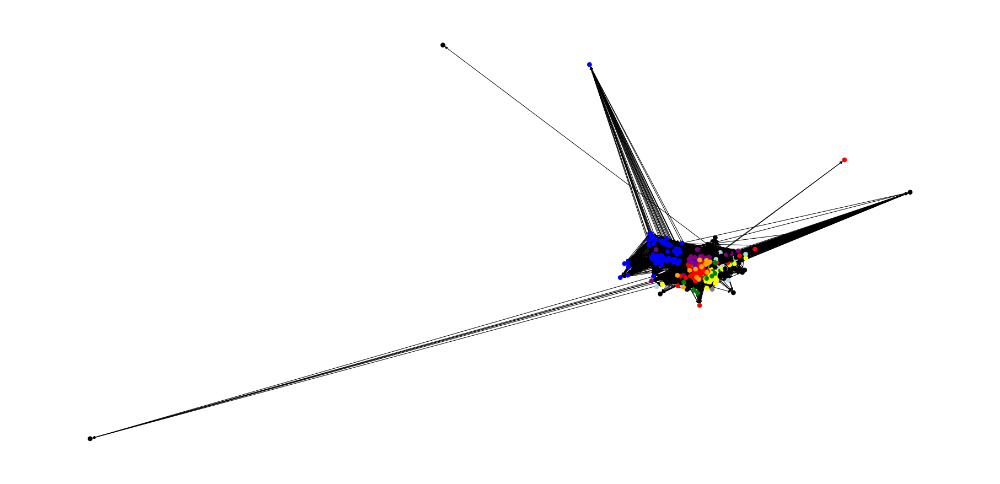

In [29]:
G = nx.DiGraph()

G.add_nodes_from(nodes)
G.add_edges_from(edges)

pos = nx.spring_layout(G)

plt.figure(figsize=(25,12))

nx.draw(G, pos, node_color=node_color_map, node_size=60)

plt.show()